<a href="https://colab.research.google.com/github/rajagopalmotivate1/COVID_NanoAID/blob/master/NanoAID_Learning_nCOV_Autoencoder.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **NanoAID, a COVID19 Researcher's toolkit** 
#https://sites.google.com/view/covid19enabler/

In [0]:
!rm -r mynewfiles
!mkdir mynewfiles

In [0]:
!wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies --no-check-certificate 'https://docs.google.com/uc?export=download&id=17WYoQaUzn2EFM4lQFya4eLgfmUeKCURn' -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id=17WYoQaUzn2EFM4lQFya4eLgfmUeKCURn" -O blue2.tar && rm -rf /tmp/cookies.txt

In [0]:
!wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies --no-check-certificate 'https://docs.google.com/uc?export=download&id=1MOzcCLol9EKY-1hEpyzPLOky-NJ39MPK' -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id=1MOzcCLol9EKY-1hEpyzPLOky-NJ39MPK" -O spike2.tar && rm -rf /tmp/cookies.txt

In [0]:
!mkdir mynewfiles
!mkdir tempzipfolder

In [0]:
!tar xvf  spike2.tar -C tempzipfolder

In [0]:
!tar xvf  blue2.tar -C tempzipfolder

In [0]:
!mkdir mynewfiles/spike
!mkdir mynewfiles/blue

In [9]:
!mv tempzipfolder/spike2/*.*    mynewfiles/spike

mv: cannot stat 'tempzipfolder/spike2/*.*': No such file or directory


In [0]:
!mv tempzipfolder/blue2/*.*    mynewfiles/blue

In [11]:
!ls mynewfiles

blue  spike


In [0]:
!mkdir mynewfilesTEM

In [0]:
!mkdir mynewfilesTEM/blue

In [0]:
from google.colab import files
#uploaded = files.upload() 


In [15]:
!wget https://raw.githubusercontent.com/rajagopalmotivate1/COVID_NanoAID/master/10.jpg

--2020-04-30 18:00:19--  https://raw.githubusercontent.com/rajagopalmotivate1/COVID_NanoAID/master/10.jpg
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 452809 (442K) [image/jpeg]
Saving to: ‘10.jpg’

10.jpg              100%[===================>] 442.20K  --.-KB/s    in 0.008s  

2020-04-30 18:00:20 (54.4 MB/s) - ‘10.jpg’ saved [452809/452809]



In [0]:
!mv 10.jpg mynewfilesTEM/blue/100.jpg

In [17]:
import os



rock_dir = os.path.join('mynewfiles/spike')
paper_dir = os.path.join('mynewfiles/blue')

print('total training  images:', len(os.listdir(rock_dir)))
print('total training  images:', len(os.listdir(paper_dir)))

rock_files = os.listdir(rock_dir)
print(rock_files[:10])

paper_files = os.listdir(paper_dir)
print(paper_files[:10])



total training  images: 647
total training  images: 623
['Screenshot - 2_22_2020 , 10_27_33 PM.png', 'Screenshot - 2_22_2020 , 9_24_54 PM.png', 'Screenshot - 2_22_2020 , 10_30_00 PM.png', 'Screenshot - 2_22_2020 , 9_14_33 PM.png', 'Screenshot - 2_22_2020 , 10_29_55 PM.png', 'Screenshot - 2_22_2020 , 9_21_50 PM.png', 'Screenshot - 2_22_2020 , 10_14_34 PM.png', 'Screenshot - 2_22_2020 , 10_30_18 PM.png', 'Screenshot - 2_22_2020 , 9_22_08 PM.png', 'Screenshot - 2_22_2020 , 9_20_25 PM.png']
['Screenshot - 2_22_2020 , 10_52_14 PM 002.png', 'Screenshot - 2_22_2020 , 11_09_43 PM.png', 'Screenshot - 2_22_2020 , 10_48_23 PM.png', 'Screenshot - 2_22_2020 , 10_38_34 PM.png', 'Screenshot - 2_22_2020 , 10_44_30 PM 002.png', 'Screenshot - 2_22_2020 , 10_42_29 PM.png', 'Screenshot - 2_22_2020 , 10_57_41 PM 002.png', 'Screenshot - 2_22_2020 , 11_07_59 PM 003.png', 'Screenshot - 2_22_2020 , 11_09_48 PM.png', 'Screenshot - 2_22_2020 , 11_06_21 PM 003.png']


In [0]:
SIZE = 224

In [19]:
import keras
from keras.datasets import mnist
from keras.models import Sequential
from keras.layers import Dense, Activation, Flatten, Input
from keras.layers import Conv2D, MaxPooling2D, UpSampling2D
import matplotlib.pyplot as plt
from keras import backend as K
import numpy as np
from keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img

from keras.preprocessing import image 


Using TensorFlow backend.


In [0]:
DATASETCLASSMODE= 'input'
#DATASETCLASSMODE= 'categorical'

In [0]:
BATCHSIZE=128

In [22]:
TRAINING_DIR = "mynewfiles/"

datagen = ImageDataGenerator(validation_split=0.1, rescale=1./255,      rotation_range=4,
     horizontal_flip=True,                                                                
     fill_mode='wrap')

train_generator = datagen.flow_from_directory(
    TRAINING_DIR, 
    subset='training',
    target_size=(SIZE,SIZE),
         shuffle=True,     batch_size=BATCHSIZE,
	  class_mode='input'
)

validation_generator = datagen.flow_from_directory(
    TRAINING_DIR,
    subset='validation',
    	target_size=(SIZE,SIZE),
         shuffle=True,     batch_size=BATCHSIZE,
	class_mode='input'
)




test_datagen = ImageDataGenerator( rescale=1./255)


test_generator = test_datagen.flow_from_directory(
    TRAINING_DIR,
    target_size=(SIZE,SIZE),
    batch_size=BATCHSIZE,
    class_mode='input',
    shuffle=True,
    seed=42
)

Found 1144 images belonging to 2 classes.
Found 126 images belonging to 2 classes.
Found 1270 images belonging to 2 classes.


In [23]:
for image_batch, label_batch in test_generator:
  print("Image batch shape: ", image_batch.shape)
  print("Label batch shape: ", label_batch.shape)
  break

Image batch shape:  (128, 224, 224, 3)
Label batch shape:  (128, 224, 224, 3)


In [24]:

# Define the model
model = Sequential()




#1st convolution layer
model.add(Conv2D(16*2, (3, 3), padding='same', input_shape=(SIZE,SIZE,3)))
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size=(2,2), padding='same'))

#2nd convolution layer
model.add(Conv2D(32*2,(3, 3), padding='same'))
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size=(2,2), padding='same'))

#2nd convolution layer
model.add(Conv2D(64*2,(3, 3), padding='same'))
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size=(2,2), padding='same'))


#3nd convolution layer
model.add(Conv2D(128*2,(3, 3), padding='same'))
model.add(Activation('relu'))
#model.add(MaxPooling2D(pool_size=(2,2), padding='same'))



model.add(Conv2D(32*2,(3, 3), padding='same'))
model.add(Activation('relu'))


model.add(Conv2D(32*2,(3, 3), padding='same'))
model.add(Activation('relu'))



model.add(Conv2D(128*2,(3, 3), padding='same'))
model.add(Activation('relu'))
#model.add(UpSampling2D((2, 2)))



model.add(Conv2D(64*2,(3, 3), padding='same'))
model.add(Activation('relu'))
model.add(UpSampling2D((2, 2)))


#-------------------------
#4rd convolution layer
model.add(Conv2D(32*2,(3, 3), padding='same'))
model.add(Activation('relu'))
model.add(UpSampling2D((2, 2)))

#5rd convolution layer
model.add(Conv2D(16*2,(3, 3), padding='same'))
model.add(Activation('relu'))
model.add(UpSampling2D((2, 2)))

#-------------------------

model.add(Conv2D(3,(3, 3), padding='same'))
model.add(Activation('sigmoid'))

model.summary()

# Compile the model
model.compile(optimizer='adadelta', loss='binary_crossentropy', metrics=['mse'])






Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 224, 224, 32)      896       
_________________________________________________________________
activation_1 (Activation)    (None, 224, 224, 32)      0         
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 112, 112, 32)      0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 112, 112, 64)      18496     
_________________________________________________________________
activation_2 (Activation)    (None, 112, 112, 64)      0         
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 56, 56, 64)        0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 56, 56, 128)      

In [0]:
steps_per_epoch = 1200 / BATCHSIZE

In [26]:
# Train the model
history = model.fit_generator( 
        train_generator,
        steps_per_epoch=1280 // BATCHSIZE,
        epochs=40,
        validation_data=validation_generator,
        validation_steps=128 // BATCHSIZE)
        



Epoch 1/40
10/10 [==============================] - 28s 3s/step - loss: 0.6774 - mse: 0.0559 - val_loss: 0.6738 - val_mse: 0.0799
Epoch 2/40
10/10 [==============================] - 18s 2s/step - loss: 0.6569 - mse: 0.0463 - val_loss: 0.6301 - val_mse: 0.0588
Epoch 3/40
10/10 [==============================] - 19s 2s/step - loss: 0.6494 - mse: 0.0426 - val_loss: 0.6380 - val_mse: 0.0624
Epoch 4/40
10/10 [==============================] - 19s 2s/step - loss: 0.6483 - mse: 0.0421 - val_loss: 0.6603 - val_mse: 0.0733
Epoch 5/40
10/10 [==============================] - 19s 2s/step - loss: 0.6462 - mse: 0.0420 - val_loss: 0.5608 - val_mse: 0.0306
Epoch 6/40
10/10 [==============================] - 19s 2s/step - loss: 0.6227 - mse: 0.0307 - val_loss: 0.5538 - val_mse: 0.0267
Epoch 7/40
10/10 [==============================] - 19s 2s/step - loss: 0.6145 - mse: 0.0276 - val_loss: 0.5360 - val_mse: 0.0192
Epoch 8/40
10/10 [==============================] - 20s 2s/step - loss: 0.6117 - mse: 0.02

In [27]:
train_generator.batch_index

0

In [28]:
# Test the model
data_list = []
batch_index = 0
while batch_index <= train_generator.batch_index:
    data = train_generator.next()
    print(data[0].shape)
    data_list.append(data[0])
    batch_index = batch_index + 1
    break



(128, 224, 224, 3)


In [29]:
data = train_generator.next()
print(data[0].shape)


(128, 224, 224, 3)


In [0]:
predictedimage = model.predict(data[0])

In [31]:
predictedimage.shape

(128, 224, 224, 3)

In [0]:
plt.imshow(data[0][69])

In [0]:
plt.imshow(predictedimage[69])

In [0]:
layer_outputs = 0

In [35]:
layer_outputs = [layer.output for layer in model.layers]
# Creates a model that will return these outputs, given the model input:
#activation_model = models.Model(inputs=pre_trained_model.input, outputs=layer_outputs)

print( layer_outputs)

print( layer_outputs[0])
print( layer_outputs[9])

[<tf.Tensor 'conv2d_1/BiasAdd:0' shape=(None, 224, 224, 32) dtype=float32>, <tf.Tensor 'activation_1/Relu:0' shape=(None, 224, 224, 32) dtype=float32>, <tf.Tensor 'max_pooling2d_1/MaxPool:0' shape=(None, 112, 112, 32) dtype=float32>, <tf.Tensor 'conv2d_2/BiasAdd:0' shape=(None, 112, 112, 64) dtype=float32>, <tf.Tensor 'activation_2/Relu:0' shape=(None, 112, 112, 64) dtype=float32>, <tf.Tensor 'max_pooling2d_2/MaxPool:0' shape=(None, 56, 56, 64) dtype=float32>, <tf.Tensor 'conv2d_3/BiasAdd:0' shape=(None, 56, 56, 128) dtype=float32>, <tf.Tensor 'activation_3/Relu:0' shape=(None, 56, 56, 128) dtype=float32>, <tf.Tensor 'max_pooling2d_3/MaxPool:0' shape=(None, 28, 28, 128) dtype=float32>, <tf.Tensor 'conv2d_4/BiasAdd:0' shape=(None, 28, 28, 256) dtype=float32>, <tf.Tensor 'activation_4/Relu:0' shape=(None, 28, 28, 256) dtype=float32>, <tf.Tensor 'conv2d_5/BiasAdd:0' shape=(None, 28, 28, 64) dtype=float32>, <tf.Tensor 'activation_5/Relu:0' shape=(None, 28, 28, 64) dtype=float32>, <tf.Tenso

In [36]:
layerindex = 1
for alayer in model.layers:
  if ("conv" in alayer.name):
    print( str(layerindex) + '  \t' + str(alayer.name) + '\t' +str(alayer.input_shape ) )
  layerindex = layerindex + 1 

1  	conv2d_1	(None, 224, 224, 3)
4  	conv2d_2	(None, 112, 112, 32)
7  	conv2d_3	(None, 56, 56, 64)
10  	conv2d_4	(None, 28, 28, 128)
12  	conv2d_5	(None, 28, 28, 256)
14  	conv2d_6	(None, 28, 28, 64)
16  	conv2d_7	(None, 28, 28, 64)
18  	conv2d_8	(None, 28, 28, 256)
21  	conv2d_9	(None, 56, 56, 128)
24  	conv2d_10	(None, 112, 112, 64)
27  	conv2d_11	(None, 224, 224, 32)


In [0]:
pic_index = 8 #@param {type:"slider", min:0, max:100, step:1}


In [0]:
NanoMaterial = 'spike' #@param ["spike", "blue"]

In [0]:
seeActivationAtLayer = 2 #@param {type:"slider", min:0, max:29, step:1}


In [0]:
from keras import models

activation_model = 0
activation_model = models.Model(model.input, outputs=layer_outputs[seeActivationAtLayer])

In [41]:
print( layer_outputs[6])

Tensor("conv2d_3/BiasAdd:0", shape=(None, 56, 56, 128), dtype=float32)


In [0]:
#@title After running this cell manually, it will auto-run if you change the selected value. { run: "auto" }
%matplotlib inline

import matplotlib.pyplot as plt
import matplotlib.image as mpimg

pic_index = 16 #@param {type:"slider", min:0, max:100, step:1}





next_paper = [os.path.join(paper_dir, fname) 
                for fname in paper_files[pic_index-2:pic_index]]


img_path = 0
#for i, img_path in enumerate(next_rock+next_paper+next_scissors):
for i, img_pathany in enumerate(next_paper):
  if True:
    img = mpimg.imread(img_pathany)
    print(img_pathany)
    print(img.shape)
    plt.imshow(img)
    plt.axis('Off')
    plt.show()
    img_path = img_pathany
    break
    
    

img = image.load_img(img_path, target_size=(224, 224))
img_tensor = image.img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis=0)
# Remember that the model was trained on inputs
# that were preprocessed in the following way:
img_tensor /= 255.

# Its shape is (1, 150, 150, 3)
print(img_tensor.shape)
plt.imshow(img)
plt.show()

predictedimage = model.predict(img_tensor)
plt.imshow(predictedimage[0])

In [0]:
#@title After running this cell manually, it will auto-run if you change the selected value. { run: "auto" }

seeActivationAtLayer = "3" #@param [1, 2, 3, 4, 5, 7, 9, 11, 13, 15, 16,17, 19, 22, 25]

seeActivationAtLayer = int (seeActivationAtLayer)

from keras import models

activation_model = 0
activation_model = models.Model(model.input, outputs=layer_outputs[seeActivationAtLayer])



activations = activation_model.predict(img_tensor)
first_layer_activation = activations[0]

layer_activation = activations[0]

images_per_row = 16

n_features = layer_activation.shape[-1]

n_features

if n_features <= 4: 
  images_per_row = 2
  
  
size = layer_activation.shape[1]

n_cols = n_features // images_per_row
display_grid = np.zeros((size * n_cols, images_per_row * size))

n_features = layer_activation.shape[-1]
size = layer_activation.shape[1]


print(n_features)

n_cols = n_features // images_per_row



display_grid =0
display_grid = np.zeros((size * n_cols, images_per_row * size))

print(n_cols)
print(display_grid.shape)

# We'll tile each filter into this big horizontal grid
if True:
  for col in range(n_cols):
    for row in range(images_per_row):
              channel_image = layer_activation[
                                               :, :,
                                               col * images_per_row + row]
              # Post-process the feature to make it visually palatable
              channel_image -= channel_image.mean()
              channel_image /= channel_image.std()
              channel_image *= 64
              channel_image += 128
              channel_image = np.clip(channel_image, 0, 255).astype('uint8')
             # print(channel_image.shape)
             # print(col * size)
             # print((col + 1) * size)
              display_grid[col * size : (col + 1) * size,
                           row * size : (row + 1) * size] = channel_image

    # Display the grid
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1] * 2 ,
                          scale * 2 * display_grid.shape[0]))
  plt.imshow(display_grid, aspect='auto', cmap='viridis')
    
plt.show()

In [0]:
#@title After running this cell manually, it will auto-run if you change the selected value. { run: "auto" }
%matplotlib inline

import matplotlib.pyplot as plt
import matplotlib.image as mpimg

pic_index = 206 #@param {type:"slider", min:0, max:500, step:1}





next_paper = [os.path.join(rock_dir, fname) 
                for fname in rock_files[pic_index-2:pic_index]]


img_path = 0
#for i, img_path in enumerate(next_rock+next_paper+next_scissors):
for i, img_pathany in enumerate(next_paper):
  if True:
    img = mpimg.imread(img_pathany)
    print(img_pathany)
    print(img.shape)
    plt.imshow(img)
    plt.axis('Off')
    plt.show()
    img_path = img_pathany
    break
    
    

img = image.load_img(img_path, target_size=(224, 224))
img_tensor = image.img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis=0)
# Remember that the model was trained on inputs
# that were preprocessed in the following way:
img_tensor /= 255.

# Its shape is (1, 150, 150, 3)
print(img_tensor.shape)
plt.imshow(img)
plt.show()

predictedimage = model.predict(img_tensor)
plt.imshow(predictedimage[0])

In [0]:
#@title After running this cell manually, it will auto-run if you change the selected value. { run: "auto" }

seeActivationAtLayer = "7" #@param [1, 2, 3, 4, 5, 6, 7, 9, 11, 13, 14, 15, 16,17, 19, 22, 25, 26, 27, 28]

seeActivationAtLayer = int (seeActivationAtLayer)

from keras import models

activation_model = 0
activation_model = models.Model(model.input, outputs=layer_outputs[seeActivationAtLayer])



activations = activation_model.predict(img_tensor)
first_layer_activation = activations[0]

layer_activation = activations[0]

images_per_row = 16

n_features = layer_activation.shape[-1]

n_features

if n_features <= 4: 
  images_per_row = 2
  
  
size = layer_activation.shape[1]

n_cols = n_features // images_per_row
display_grid = np.zeros((size * n_cols, images_per_row * size))

n_features = layer_activation.shape[-1]
size = layer_activation.shape[1]


print(n_features)

n_cols = n_features // images_per_row



display_grid =0
display_grid = np.zeros((size * n_cols, images_per_row * size))

print(n_cols)
print(display_grid.shape)

# We'll tile each filter into this big horizontal grid
if True:
  for col in range(n_cols):
    for row in range(images_per_row):
              channel_image = layer_activation[
                                               :, :,
                                               col * images_per_row + row]
              # Post-process the feature to make it visually palatable
              channel_image -= channel_image.mean()
              channel_image /= channel_image.std()
              channel_image *= 64
              channel_image += 128
              channel_image = np.clip(channel_image, 0, 255).astype('uint8')
             # print(channel_image.shape)
             # print(col * size)
             # print((col + 1) * size)
              display_grid[col * size : (col + 1) * size,
                           row * size : (row + 1) * size] = channel_image

    # Display the grid
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1] * 2 ,
                          scale * 2 * display_grid.shape[0]))
  plt.imshow(display_grid, aspect='auto', cmap='viridis')
    
plt.show()


from keras.utils import plot_model
plot_model(activation_model, show_shapes=True, show_layer_names=False, to_file='model.png')

In [0]:
# We preprocess the image into a 4D tensor
from keras.preprocessing import image
import numpy as np

img = image.load_img(img_path, target_size=(224, 224))
img_tensor = image.img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis=0)
# Remember that the model was trained on inputs
# that were preprocessed in the following way:
img_tensor /= 255.

# Its shape is (1, 150, 150, 3)
print(img_tensor.shape)
plt.imshow(img)


In [0]:
activations = activation_model.predict(img_tensor)


In [48]:
activations.shape

(1, 56, 56, 128)

In [49]:
first_layer_activation = activations[0]
print(first_layer_activation.shape)

(56, 56, 128)


In [0]:
import matplotlib.pyplot as plt



In [0]:
layer_activation = activations[0]


In [0]:
images_per_row = 16

n_features = layer_activation.shape[-1]

n_features

if n_features <= 4: 
  images_per_row = 2

In [53]:
size = layer_activation.shape[1]
size

56

In [0]:
n_cols = n_features // images_per_row
display_grid = np.zeros((size * n_cols, images_per_row * size))

In [0]:
n_features = layer_activation.shape[-1]
size = layer_activation.shape[1]


print(n_features)

n_cols = n_features // images_per_row



display_grid =0
display_grid = np.zeros((size * n_cols, images_per_row * size))

print(n_cols)
print(display_grid.shape)

# We'll tile each filter into this big horizontal grid
if True:
  for col in range(n_cols):
    for row in range(images_per_row):
              channel_image = layer_activation[
                                               :, :,
                                               col * images_per_row + row]
              # Post-process the feature to make it visually palatable
              channel_image -= channel_image.mean()
              channel_image /= channel_image.std()
              channel_image *= 64
              channel_image += 128
              channel_image = np.clip(channel_image, 0, 255).astype('uint8')
             # print(channel_image.shape)
             # print(col * size)
             # print((col + 1) * size)
              display_grid[col * size : (col + 1) * size,
                           row * size : (row + 1) * size] = channel_image

    # Display the grid
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1] * 2 ,
                          scale * 2 * display_grid.shape[0]))
  plt.imshow(display_grid, aspect='auto', cmap='viridis')
    
plt.show()

In [56]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 224, 224, 32)      896       
_________________________________________________________________
activation_1 (Activation)    (None, 224, 224, 32)      0         
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 112, 112, 32)      0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 112, 112, 64)      18496     
_________________________________________________________________
activation_2 (Activation)    (None, 112, 112, 64)      0         
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 56, 56, 64)        0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 56, 56, 128)      

In [0]:
from keras.applications import VGG16
from keras import backend as K


layer_name = 'conv2d_3'
filter_index = 0

layer_output = model.get_layer(layer_name).output
loss = K.mean(layer_output[:, :, :, filter_index])

In [58]:
!ls mynewfilesTEM/blue

100.jpg


In [59]:
TRAINING_DIR = "mynewfilesTEM/"

datagen = ImageDataGenerator(validation_split=0.1, rescale=1./255,      rotation_range=4,
     horizontal_flip=True,                                                                
     fill_mode='wrap')

train_generator = datagen.flow_from_directory(
    TRAINING_DIR, 
    subset='training',
    target_size=(SIZE,SIZE),
         shuffle=True,     batch_size=BATCHSIZE,
	  class_mode='input'
)

validation_generator = datagen.flow_from_directory(
    TRAINING_DIR,
    subset='validation',
    	target_size=(SIZE,SIZE),
         shuffle=True,     batch_size=BATCHSIZE,
	class_mode='input'
)




test_datagen = ImageDataGenerator( rescale=1./255)


test_generator = test_datagen.flow_from_directory(
    TRAINING_DIR,
    target_size=(SIZE,SIZE),
    batch_size=BATCHSIZE,
    class_mode='input',
    shuffle=True,
    seed=42
)

Found 1 images belonging to 1 classes.
Found 0 images belonging to 1 classes.
Found 1 images belonging to 1 classes.


In [0]:
from google.colab import files
#uploaded = files.upload() 


In [61]:
!wget https://raw.githubusercontent.com/rajagopalmotivate1/COVID_NanoAID/master/10.jpg

--2020-04-30 18:14:11--  https://raw.githubusercontent.com/rajagopalmotivate1/COVID_NanoAID/master/10.jpg
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 452809 (442K) [image/jpeg]
Saving to: ‘10.jpg’

10.jpg              100%[===================>] 442.20K  --.-KB/s    in 0.009s  

2020-04-30 18:14:12 (49.0 MB/s) - ‘10.jpg’ saved [452809/452809]



In [62]:
!wget https://raw.githubusercontent.com/rajagopalmotivate1/COVID_NanoAID/master/25.JPG

--2020-04-30 18:14:26--  https://raw.githubusercontent.com/rajagopalmotivate1/COVID_NanoAID/master/25.JPG
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 99448 (97K) [image/jpeg]
Saving to: ‘25.JPG’

25.JPG              100%[===================>]  97.12K  --.-KB/s    in 0.004s  

2020-04-30 18:14:27 (25.9 MB/s) - ‘25.JPG’ saved [99448/99448]



In [63]:
!wget https://raw.githubusercontent.com/rajagopalmotivate1/COVID_NanoAID/master/30.PNG

--2020-04-30 18:14:33--  https://raw.githubusercontent.com/rajagopalmotivate1/COVID_NanoAID/master/30.PNG
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1046978 (1022K) [image/png]
Saving to: ‘30.PNG’

30.PNG              100%[===================>]   1022K  --.-KB/s    in 0.02s   

2020-04-30 18:14:34 (48.6 MB/s) - ‘30.PNG’ saved [1046978/1046978]



In [0]:
!mv 10.jpg mynewfilesTEM/blue/1.jpg

In [0]:
!mv 25.JPG mynewfilesTEM/blue/2.jpg

In [0]:
!mv 30.PNG mynewfilesTEM/blue/3.jpg

In [0]:
paper_dir = os.path.join('mynewfilesTEM/blue')
paper_files = os.listdir(paper_dir)


mynewfilesTEM/blue/100.jpg
(903, 881, 3)


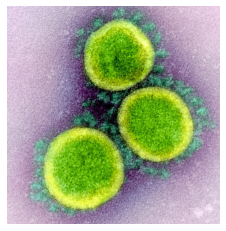

(1, 224, 224, 3)


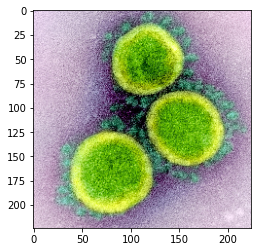

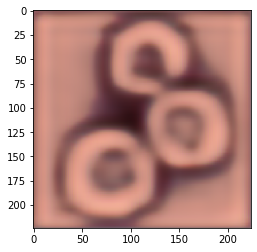

In [68]:
#@title After running this cell manually, it will auto-run if you change the selected value. { run: "auto" }
%matplotlib inline

import matplotlib.pyplot as plt
import matplotlib.image as mpimg

pic_index = 2 #@param {type:"slider", min:1, max:4, step:1}





next_paper = [os.path.join(paper_dir, fname) 
                for fname in paper_files[pic_index-1:pic_index]]


img_path = 0
#for i, img_path in enumerate(next_rock+next_paper+next_scissors):
for i, img_pathany in enumerate(next_paper):
  if True:
    img = mpimg.imread(img_pathany)
    print(img_pathany)
    print(img.shape)
    plt.imshow(img)
    plt.axis('Off')
    plt.show()
    img_path = img_pathany
    break
    
    

img = image.load_img(img_path, target_size=(224, 224))
img_tensor = image.img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis=0)
# Remember that the model was trained on inputs
# that were preprocessed in the following way:
img_tensor /= 255.

# Its shape is (1, 150, 150, 3)
print(img_tensor.shape)
plt.imshow(img)
plt.show()

predictedimage = model.predict(img_tensor)
plt.imshow(predictedimage[0])

32
2
(224, 1792)


<Figure size 4608x576 with 0 Axes>

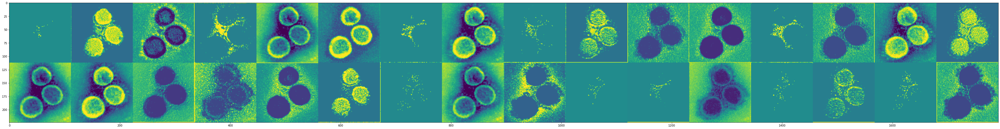

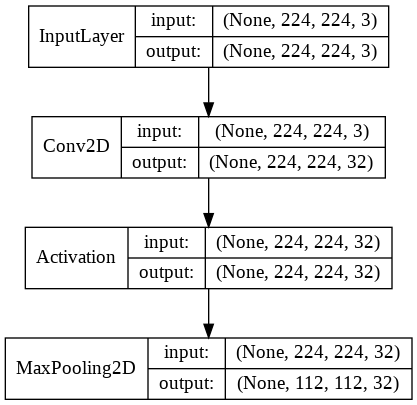

In [69]:
#@title After running this cell manually, it will auto-run if you change the selected value. { run: "auto" }

seeActivationAtLayer = "2" #@param [1, 2, 3, 4, 5, 6, 7, 9, 11, 13, 14, 15, 16,17, 19, 22, 25, 26, 27, 28]

seeActivationAtLayer = int (seeActivationAtLayer)

from keras import models

activation_model = 0
activation_model = models.Model(model.input, outputs=layer_outputs[seeActivationAtLayer])



activations = activation_model.predict(img_tensor)
first_layer_activation = activations[0]

layer_activation = activations[0]

images_per_row = 16

n_features = layer_activation.shape[-1]

n_features

if n_features <= 4: 
  images_per_row = 2
  
  
size = layer_activation.shape[1]

n_cols = n_features // images_per_row
display_grid = np.zeros((size * n_cols, images_per_row * size))

n_features = layer_activation.shape[-1]
size = layer_activation.shape[1]


print(n_features)

n_cols = n_features // images_per_row



display_grid =0
display_grid = np.zeros((size * n_cols, images_per_row * size))

print(n_cols)
print(display_grid.shape)

# We'll tile each filter into this big horizontal grid
if True:
  for col in range(n_cols):
    for row in range(images_per_row):
              channel_image = layer_activation[
                                               :, :,
                                               col * images_per_row + row]
              # Post-process the feature to make it visually palatable
              channel_image -= channel_image.mean()
              channel_image /= channel_image.std()
              channel_image *= 64
              channel_image += 128
              channel_image = np.clip(channel_image, 0, 255).astype('uint8')
             # print(channel_image.shape)
             # print(col * size)
             # print((col + 1) * size)
              display_grid[col * size : (col + 1) * size,
                           row * size : (row + 1) * size] = channel_image

    # Display the grid
    scale = 1. / size * 2
    plt.figure(figsize=(scale * display_grid.shape[1] * 2 ,
                          scale * 2 * display_grid.shape[0]))
  plt.imshow(display_grid, aspect='auto', cmap='viridis')
    
plt.show()


from keras.utils import plot_model
plot_model(activation_model, show_shapes=True, show_layer_names=False, to_file='model.png')

In [0]:
#@title Save channel that filter SARS-COV-2 spikes 

Feature1_layernumber = 1 #@param {type:"number"}
Feature1_channelnumber = 1 #@param {type:"number"}



In [0]:
#@title Save channel that filter SARS-COV-2 shape 

Feature1a_layernumber = 3 #@param {type:"number"}
Feature1a_channelnumber = 0 #@param {type:"number"}

In [0]:
#@title Save channel that filter SARS-COV-2 shape 

Feature2_layernumber = 3 #@param {type:"number"}
Feature2_channelnumber = 63 #@param {type:"number"}

In [0]:
#@title Save channel that filter SARS-COV-2 shape 

Feature3_layernumber = 1 #@param {type:"number"}
Feature3_channelnumber = 14 #@param {type:"number"}

In [0]:
import copy
def plotrequiredchannel(seeActivationAtLayer, channel):
  print('       layer: ' + str(seeActivationAtLayer) + ',  channel: ' + str(channel))
  activation_model = models.Model(model.input, outputs=layer_outputs[seeActivationAtLayer])
  activations = activation_model.predict(img_tensor)
  first_layer_activation = activations[0]
  channelimage = first_layer_activation[:, :, 0+channel:1+channel]
  #print(channelimage.shape[0])   #(56,56)
  sizeofthechannelimage = channelimage.shape[0]  
  newimage22 = np.reshape(channelimage, (sizeofthechannelimage,sizeofthechannelimage))
  newimage23 = copy.deepcopy(newimage22)
  newimage22.shape
  newimage22 -= newimage22.mean()
  newimage22 /= newimage22.std()
  newimage22 *= 64
  newimage22 += 128
  newimage22 = np.clip(newimage22, 0, 255).astype('uint8')
  plt.imshow(newimage22)
  print(newimage22.shape)
  return newimage23
   

       layer: 1,  channel: 1
(224, 224)


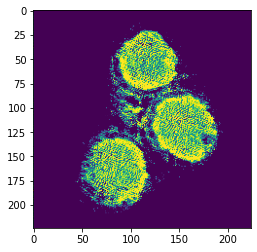

In [75]:
temp = plotrequiredchannel(Feature1_layernumber, Feature1_channelnumber)


       layer: 3,  channel: 0
(112, 112)


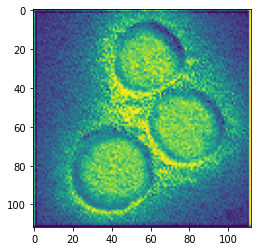

In [76]:
temp = plotrequiredchannel(Feature1a_layernumber, Feature1a_channelnumber)


       layer: 3,  channel: 63
(112, 112)


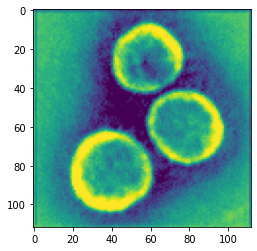

In [77]:
temp = plotrequiredchannel(Feature2_layernumber, Feature2_channelnumber)


       layer: 1,  channel: 14
(224, 224)


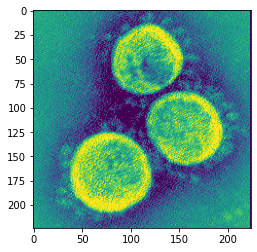

In [78]:
temp = plotrequiredchannel(Feature3_layernumber, Feature3_channelnumber)


       layer: 1,  channel: 19
(224, 224)
       layer: 1,  channel: 2
(224, 224)


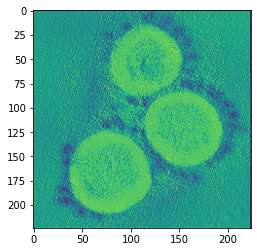

In [79]:

plt.imshow(plotrequiredchannel(1, 19)-plotrequiredchannel(1, 2))

       layer: 1,  channel: 14
(224, 224)
       layer: 1,  channel: 31
(224, 224)


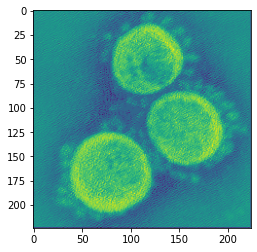

In [80]:
plt.imshow(plotrequiredchannel(1, 14)-plotrequiredchannel(1, 31))

       layer: 1,  channel: 1
(224, 224)


array([[0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.03320432, 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.02120548, 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.04145995, 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.0266564 , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.03815689, 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ]], dtype=float32)

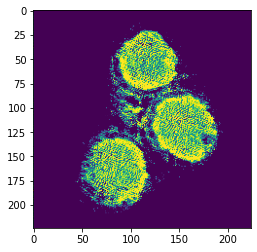

In [81]:

plotrequiredchannel(1, 1)



       layer: 3,  channel: 63
(112, 112)


array([[ 0.00445008, -0.02856515,  0.01796159, ...,  0.02124045,
         0.04262307, -0.00751471],
       [ 0.13244843,  0.03363665,  0.08636454, ...,  0.11284628,
         0.13338828,  0.05298813],
       [ 0.15845218,  0.06952498,  0.14144444, ...,  0.15486404,
         0.16143247,  0.0719812 ],
       ...,
       [ 0.15515372,  0.06977797,  0.13945362, ...,  0.14282957,
         0.15851474,  0.07051056],
       [ 0.14089647,  0.1035249 ,  0.14798108, ...,  0.14753804,
         0.1576671 ,  0.07385653],
       [ 0.1715568 ,  0.13133675,  0.15458584, ...,  0.15721428,
         0.15402564,  0.11151692]], dtype=float32)

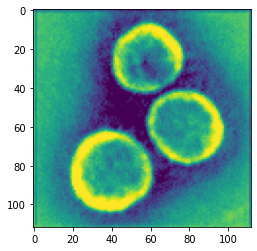

In [82]:
plotrequiredchannel(3, 63)


       layer: 6,  channel: 125
(56, 56)


array([[ 0.05682695,  0.18756534,  0.20261665, ...,  0.18942903,
         0.20980547,  0.28456253],
       [-0.0570465 ,  0.03774122,  0.02011227, ...,  0.01158934,
         0.02414354,  0.14830852],
       [-0.08206347,  0.01060614,  0.00521555, ...,  0.0028303 ,
         0.00720499,  0.14973909],
       ...,
       [-0.07528084,  0.02519023,  0.02008678, ..., -0.00389018,
         0.00824945,  0.14976582],
       [-0.06003613,  0.0398987 ,  0.0354574 , ...,  0.03022631,
         0.03638341,  0.14585046],
       [-0.18323973, -0.09060613, -0.10892028, ..., -0.1289099 ,
        -0.13606836,  0.00928561]], dtype=float32)

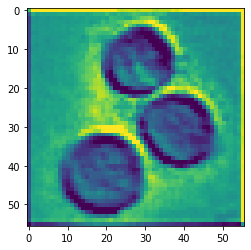

In [83]:
plotrequiredchannel(6, 125)


       layer: 1,  channel: 2
(224, 224)


array([[0.06031094, 0.20959657, 0.20387481, ..., 0.19350982, 0.1957883 ,
        0.09656226],
       [0.        , 0.06681312, 0.10448035, ..., 0.06458281, 0.09513913,
        0.22289495],
       [0.        , 0.11109599, 0.11059488, ..., 0.09991335, 0.09002788,
        0.23038891],
       ...,
       [0.        , 0.07378694, 0.08205821, ..., 0.08065896, 0.13145705,
        0.21697176],
       [0.        , 0.08440413, 0.09157325, ..., 0.0714828 , 0.08408774,
        0.22879745],
       [0.        , 0.06616219, 0.04637272, ..., 0.03841186, 0.05034351,
        0.2539504 ]], dtype=float32)

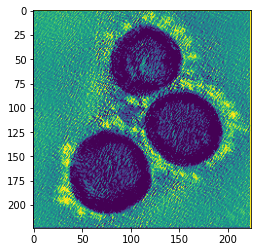

In [84]:
plotrequiredchannel(1, 2)


       layer: 2,  channel: 31
(112, 112)


array([[0.1931692 , 0.08347157, 0.0842248 , ..., 0.09576762, 0.0741777 ,
        0.05789407],
       [0.20272186, 0.08488169, 0.10354584, ..., 0.11273421, 0.11271485,
        0.08864851],
       [0.2242478 , 0.10139298, 0.07888803, ..., 0.11473269, 0.11070686,
        0.08926293],
       ...,
       [0.17176701, 0.08039385, 0.06623841, ..., 0.09277303, 0.09256113,
        0.04837354],
       [0.1969539 , 0.06433701, 0.07292102, ..., 0.06443652, 0.07904685,
        0.04503573],
       [0.22673137, 0.23486285, 0.23922671, ..., 0.23392998, 0.24070139,
        0.2380207 ]], dtype=float32)

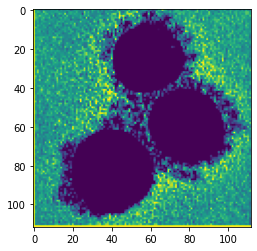

In [85]:
plotrequiredchannel(2, 31)


       layer: 1,  channel: 0
(224, 224)
       layer: 1,  channel: 11
(224, 224)


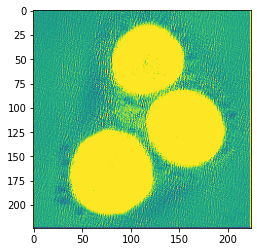

       layer: 1,  channel: 1
(224, 224)
       layer: 1,  channel: 11
(224, 224)


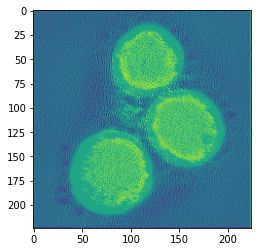

       layer: 1,  channel: 2
(224, 224)
       layer: 1,  channel: 11
(224, 224)


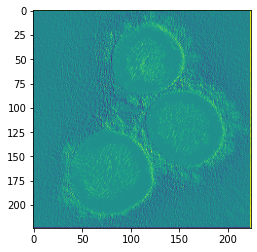

       layer: 1,  channel: 3
(224, 224)
       layer: 1,  channel: 11
(224, 224)


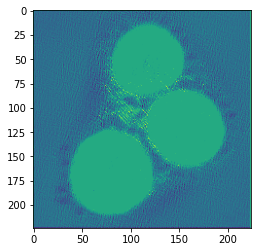

       layer: 1,  channel: 4
(224, 224)
       layer: 1,  channel: 11
(224, 224)


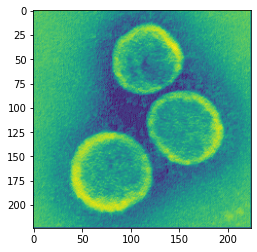

       layer: 1,  channel: 5
(224, 224)
       layer: 1,  channel: 11
(224, 224)


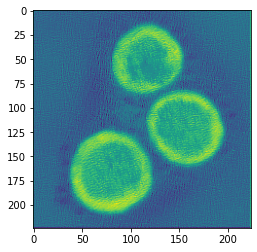

       layer: 1,  channel: 6
(224, 224)
       layer: 1,  channel: 11
(224, 224)


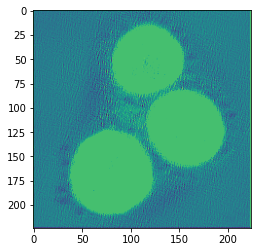

       layer: 1,  channel: 7
(224, 224)
       layer: 1,  channel: 11
(224, 224)


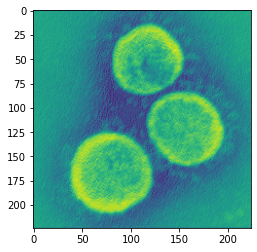

       layer: 1,  channel: 8
(224, 224)
       layer: 1,  channel: 11
(224, 224)


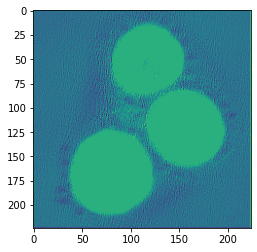

       layer: 1,  channel: 9
(224, 224)
       layer: 1,  channel: 11
(224, 224)


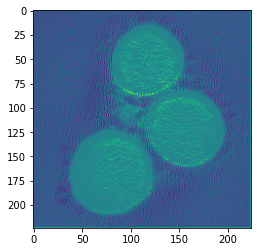

       layer: 1,  channel: 10
(224, 224)
       layer: 1,  channel: 11
(224, 224)


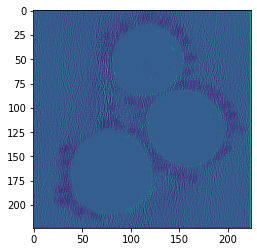

       layer: 1,  channel: 11
(224, 224)
       layer: 1,  channel: 11
(224, 224)


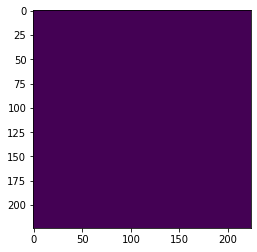

       layer: 1,  channel: 12
(224, 224)
       layer: 1,  channel: 11
(224, 224)


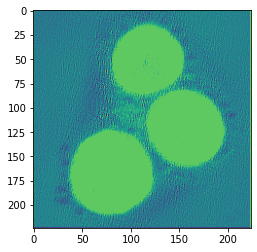

       layer: 1,  channel: 13
(224, 224)
       layer: 1,  channel: 11
(224, 224)


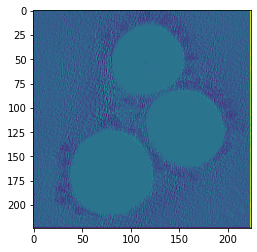

       layer: 1,  channel: 14
(224, 224)
       layer: 1,  channel: 11
(224, 224)


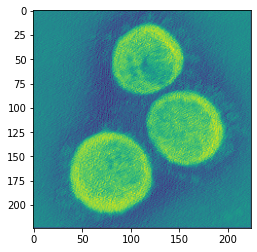

       layer: 1,  channel: 15
(224, 224)
       layer: 1,  channel: 11
(224, 224)


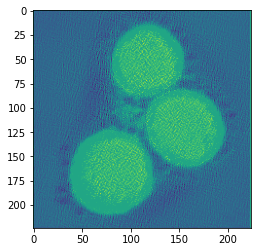

       layer: 1,  channel: 16
(224, 224)
       layer: 1,  channel: 11
(224, 224)


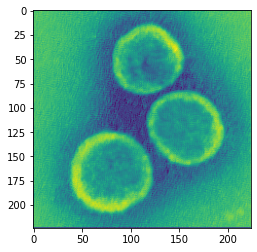

       layer: 1,  channel: 17
(224, 224)
       layer: 1,  channel: 11
(224, 224)


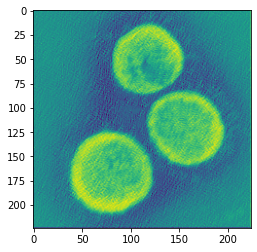

       layer: 1,  channel: 18
(224, 224)
       layer: 1,  channel: 11
(224, 224)


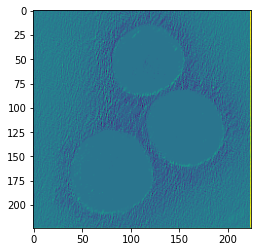

       layer: 1,  channel: 19
(224, 224)
       layer: 1,  channel: 11
(224, 224)


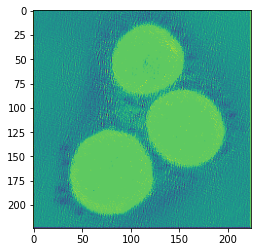

       layer: 1,  channel: 20
(224, 224)
       layer: 1,  channel: 11
(224, 224)


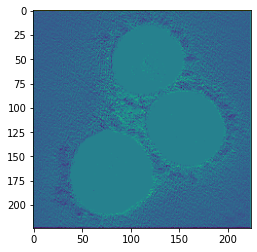

       layer: 1,  channel: 21
(224, 224)
       layer: 1,  channel: 11
(224, 224)


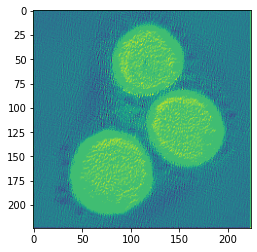

       layer: 1,  channel: 22
(224, 224)
       layer: 1,  channel: 11
(224, 224)


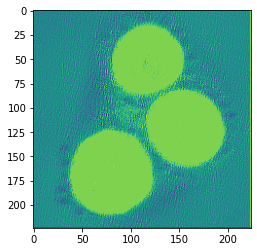

       layer: 1,  channel: 23
(224, 224)
       layer: 1,  channel: 11
(224, 224)


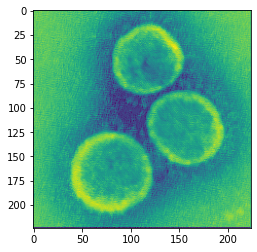

       layer: 1,  channel: 24
(224, 224)
       layer: 1,  channel: 11
(224, 224)


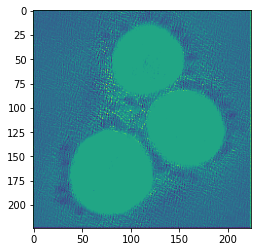

       layer: 1,  channel: 25
(224, 224)
       layer: 1,  channel: 11
(224, 224)


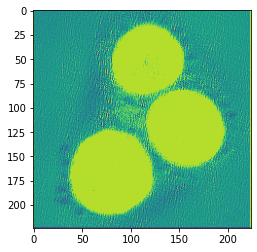

       layer: 1,  channel: 26
(224, 224)
       layer: 1,  channel: 11
(224, 224)


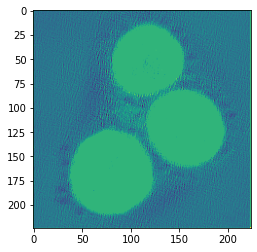

       layer: 1,  channel: 27
(224, 224)
       layer: 1,  channel: 11
(224, 224)


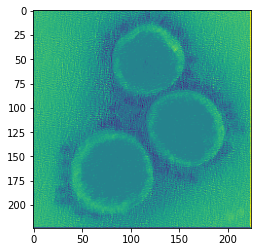

       layer: 1,  channel: 28
(224, 224)
       layer: 1,  channel: 11
(224, 224)


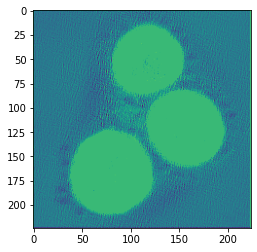

       layer: 1,  channel: 29
(224, 224)
       layer: 1,  channel: 11
(224, 224)


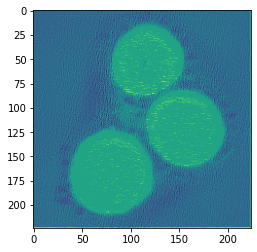

       layer: 1,  channel: 30
(224, 224)
       layer: 1,  channel: 11
(224, 224)


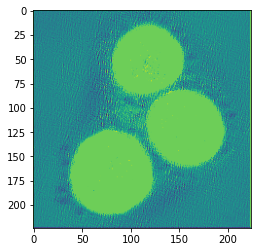

In [86]:
for i in range(0,31):
  imag1 = plotrequiredchannel(1, i)
  imag2 = plotrequiredchannel(1, 11)
  plt.imshow(imag1-imag2)
  plt.show()


       layer: 1,  channel: 0
(224, 224)
       layer: 1,  channel: 31
(224, 224)
0


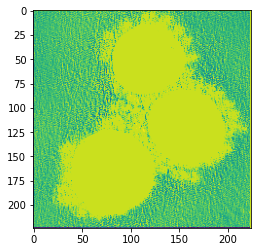

       layer: 1,  channel: 1
(224, 224)
       layer: 1,  channel: 31
(224, 224)
1


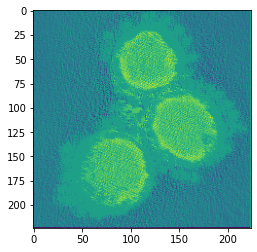

       layer: 1,  channel: 2
(224, 224)
       layer: 1,  channel: 31
(224, 224)
2


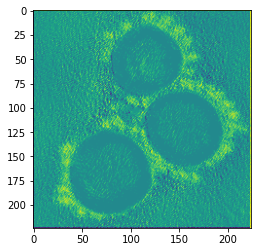

       layer: 1,  channel: 3
(224, 224)
       layer: 1,  channel: 31
(224, 224)
3


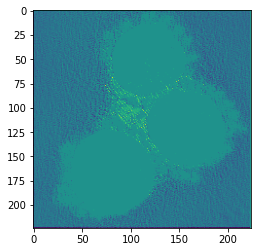

       layer: 1,  channel: 4
(224, 224)
       layer: 1,  channel: 31
(224, 224)
4


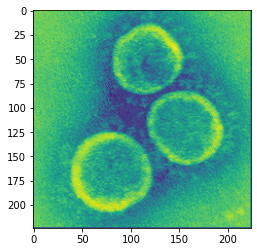

       layer: 1,  channel: 5
(224, 224)
       layer: 1,  channel: 31
(224, 224)
5


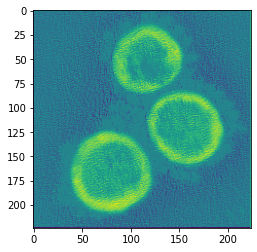

       layer: 1,  channel: 6
(224, 224)
       layer: 1,  channel: 31
(224, 224)
6


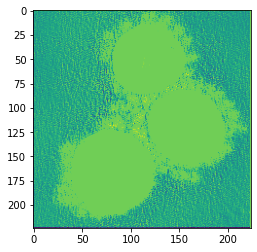

       layer: 1,  channel: 7
(224, 224)
       layer: 1,  channel: 31
(224, 224)
7


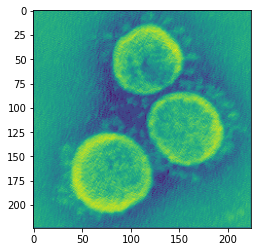

       layer: 1,  channel: 8
(224, 224)
       layer: 1,  channel: 31
(224, 224)
8


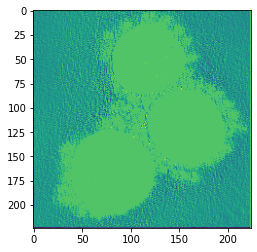

       layer: 1,  channel: 9
(224, 224)
       layer: 1,  channel: 31
(224, 224)
9


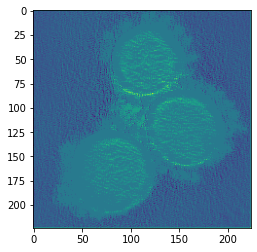

       layer: 1,  channel: 10
(224, 224)
       layer: 1,  channel: 31
(224, 224)
10


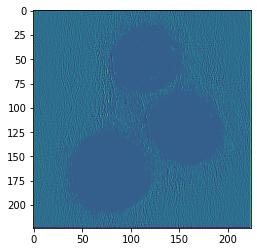

       layer: 1,  channel: 11
(224, 224)
       layer: 1,  channel: 31
(224, 224)
11


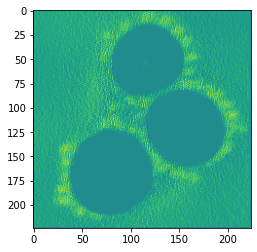

       layer: 1,  channel: 12
(224, 224)
       layer: 1,  channel: 31
(224, 224)
12


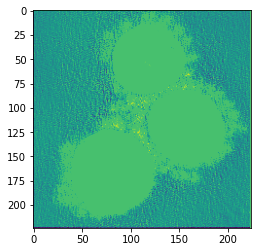

       layer: 1,  channel: 13
(224, 224)
       layer: 1,  channel: 31
(224, 224)
13


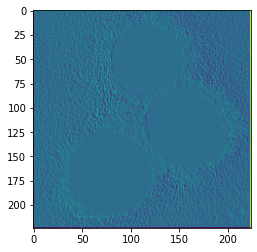

       layer: 1,  channel: 14
(224, 224)
       layer: 1,  channel: 31
(224, 224)
14


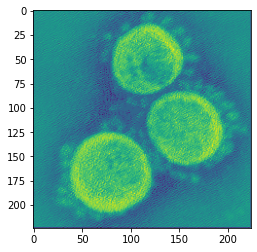

       layer: 1,  channel: 15
(224, 224)
       layer: 1,  channel: 31
(224, 224)
15


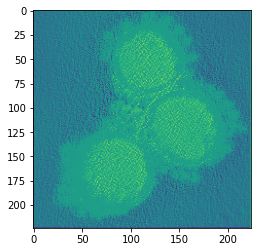

       layer: 1,  channel: 16
(224, 224)
       layer: 1,  channel: 31
(224, 224)
16


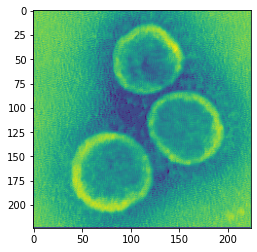

       layer: 1,  channel: 17
(224, 224)
       layer: 1,  channel: 31
(224, 224)
17


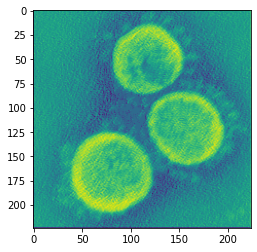

       layer: 1,  channel: 18
(224, 224)
       layer: 1,  channel: 31
(224, 224)
18


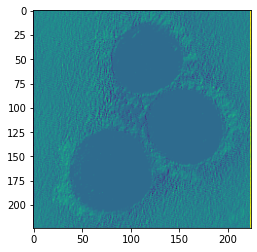

       layer: 1,  channel: 19
(224, 224)
       layer: 1,  channel: 31
(224, 224)
19


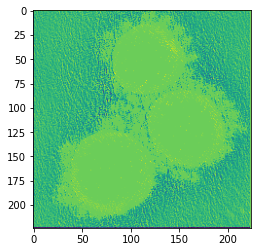

       layer: 1,  channel: 20
(224, 224)
       layer: 1,  channel: 31
(224, 224)
20


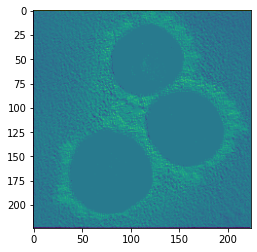

       layer: 1,  channel: 21
(224, 224)
       layer: 1,  channel: 31
(224, 224)
21


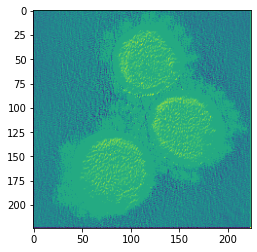

       layer: 1,  channel: 22
(224, 224)
       layer: 1,  channel: 31
(224, 224)
22


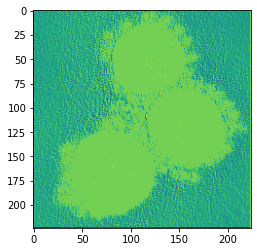

       layer: 1,  channel: 23
(224, 224)
       layer: 1,  channel: 31
(224, 224)
23


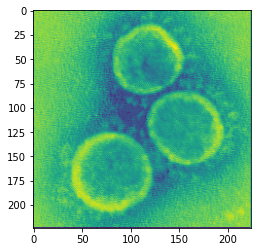

       layer: 1,  channel: 24
(224, 224)
       layer: 1,  channel: 31
(224, 224)
24


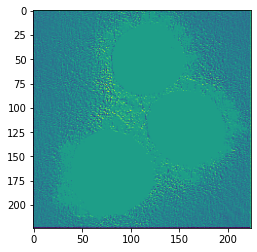

       layer: 1,  channel: 25
(224, 224)
       layer: 1,  channel: 31
(224, 224)
25


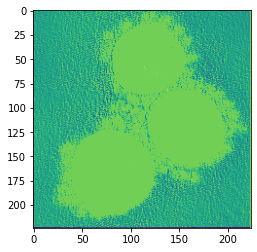

       layer: 1,  channel: 26
(224, 224)
       layer: 1,  channel: 31
(224, 224)
26


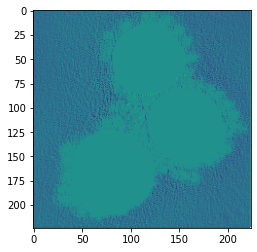

       layer: 1,  channel: 27
(224, 224)
       layer: 1,  channel: 31
(224, 224)
27


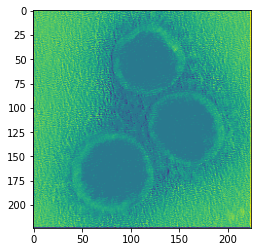

       layer: 1,  channel: 28
(224, 224)
       layer: 1,  channel: 31
(224, 224)
28


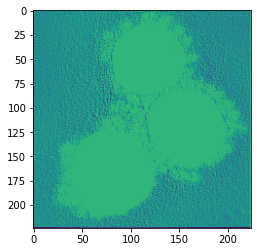

       layer: 1,  channel: 29
(224, 224)
       layer: 1,  channel: 31
(224, 224)
29


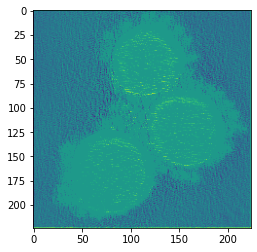

       layer: 1,  channel: 30
(224, 224)
       layer: 1,  channel: 31
(224, 224)
30


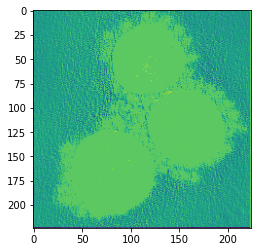

In [87]:
for i in range(0,31):
  imag1 = plotrequiredchannel(1, i)
  imag2 = plotrequiredchannel(1, 31)
  print(i)
  plt.imshow(imag1-imag2)
  plt.show()


       layer: 1,  channel: 0
(224, 224)
       layer: 1,  channel: 2
(224, 224)


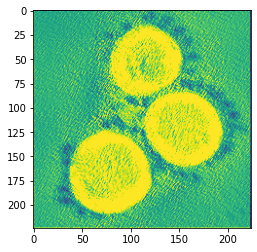

       layer: 1,  channel: 1
(224, 224)
       layer: 1,  channel: 2
(224, 224)


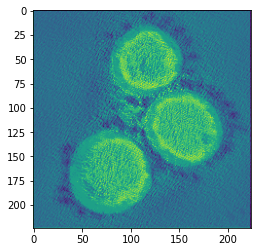

       layer: 1,  channel: 2
(224, 224)
       layer: 1,  channel: 2
(224, 224)


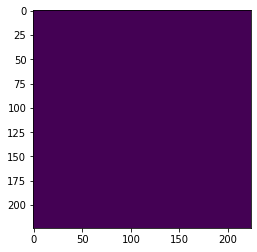

       layer: 1,  channel: 3
(224, 224)
       layer: 1,  channel: 2
(224, 224)


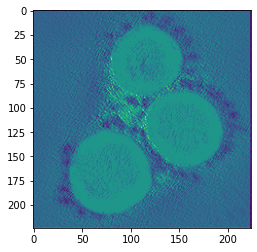

       layer: 1,  channel: 4
(224, 224)
       layer: 1,  channel: 2
(224, 224)


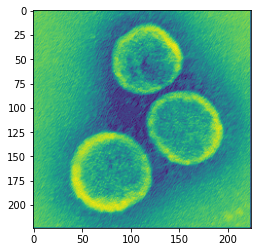

       layer: 1,  channel: 5
(224, 224)
       layer: 1,  channel: 2
(224, 224)


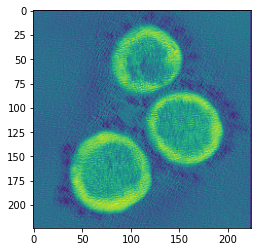

       layer: 1,  channel: 6
(224, 224)
       layer: 1,  channel: 2
(224, 224)


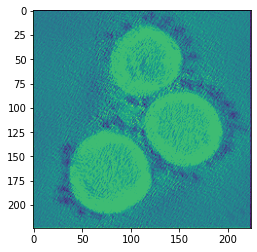

       layer: 1,  channel: 7
(224, 224)
       layer: 1,  channel: 2
(224, 224)


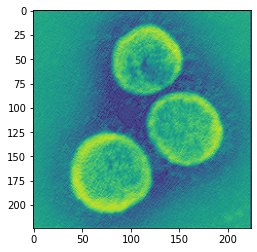

       layer: 1,  channel: 8
(224, 224)
       layer: 1,  channel: 2
(224, 224)


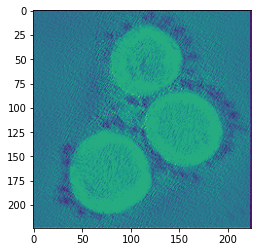

       layer: 1,  channel: 9
(224, 224)
       layer: 1,  channel: 2
(224, 224)


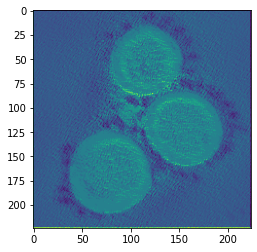

       layer: 1,  channel: 10
(224, 224)
       layer: 1,  channel: 2
(224, 224)


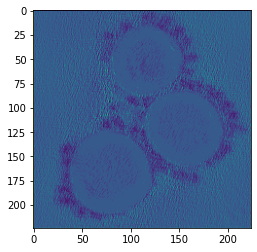

       layer: 1,  channel: 11
(224, 224)
       layer: 1,  channel: 2
(224, 224)


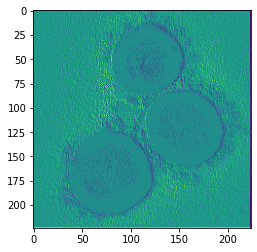

       layer: 1,  channel: 12
(224, 224)
       layer: 1,  channel: 2
(224, 224)


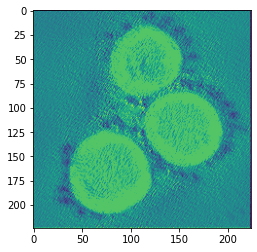

       layer: 1,  channel: 13
(224, 224)
       layer: 1,  channel: 2
(224, 224)


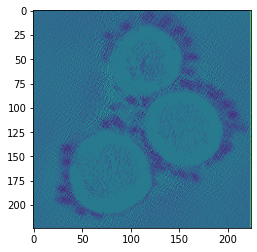

       layer: 1,  channel: 14
(224, 224)
       layer: 1,  channel: 2
(224, 224)


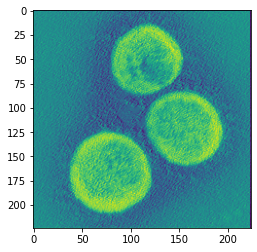

       layer: 1,  channel: 15
(224, 224)
       layer: 1,  channel: 2
(224, 224)


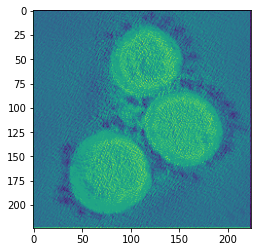

       layer: 1,  channel: 16
(224, 224)
       layer: 1,  channel: 2
(224, 224)


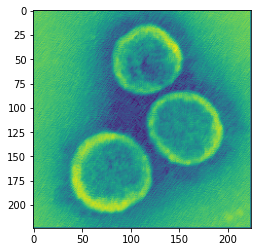

       layer: 1,  channel: 17
(224, 224)
       layer: 1,  channel: 2
(224, 224)


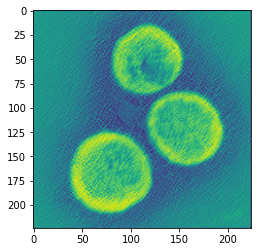

       layer: 1,  channel: 18
(224, 224)
       layer: 1,  channel: 2
(224, 224)


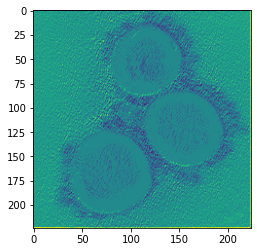

       layer: 1,  channel: 19
(224, 224)
       layer: 1,  channel: 2
(224, 224)


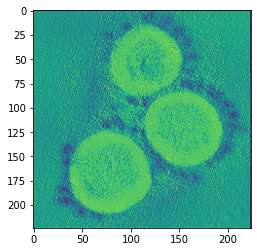

       layer: 1,  channel: 20
(224, 224)
       layer: 1,  channel: 2
(224, 224)


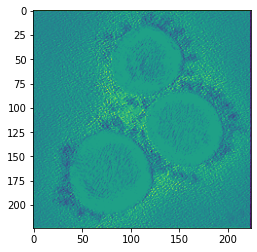

       layer: 1,  channel: 21
(224, 224)
       layer: 1,  channel: 2
(224, 224)


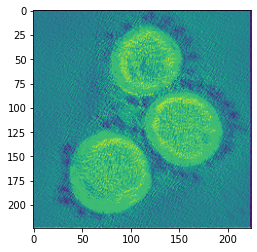

       layer: 1,  channel: 22
(224, 224)
       layer: 1,  channel: 2
(224, 224)


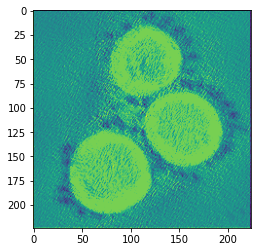

       layer: 1,  channel: 23
(224, 224)
       layer: 1,  channel: 2
(224, 224)


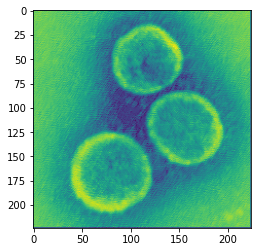

       layer: 1,  channel: 24
(224, 224)
       layer: 1,  channel: 2
(224, 224)


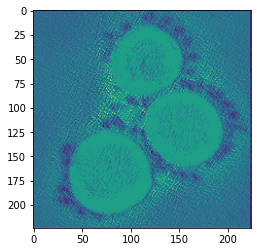

       layer: 1,  channel: 25
(224, 224)
       layer: 1,  channel: 2
(224, 224)


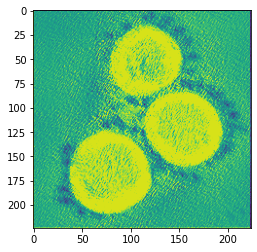

       layer: 1,  channel: 26
(224, 224)
       layer: 1,  channel: 2
(224, 224)


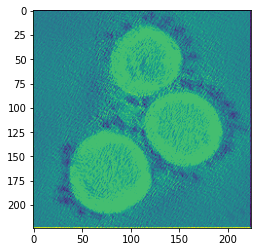

       layer: 1,  channel: 27
(224, 224)
       layer: 1,  channel: 2
(224, 224)


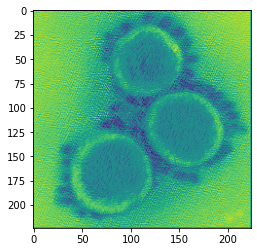

       layer: 1,  channel: 28
(224, 224)
       layer: 1,  channel: 2
(224, 224)


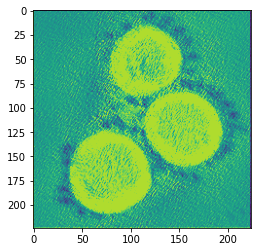

       layer: 1,  channel: 29
(224, 224)
       layer: 1,  channel: 2
(224, 224)


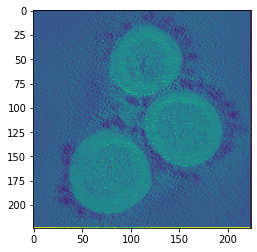

       layer: 1,  channel: 30
(224, 224)
       layer: 1,  channel: 2
(224, 224)


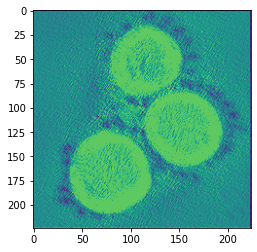

In [88]:
for i in range(0,31):
  imag1 = plotrequiredchannel(1, i)
  imag2 = plotrequiredchannel(1, 2)
  plt.imshow(imag1-imag2)
  plt.show()


       layer: 3,  channel: 0
(112, 112)
       layer: 3,  channel: 0
(112, 112)
0


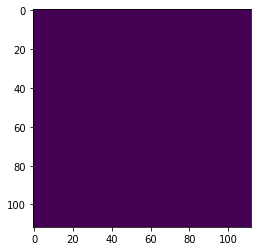

       layer: 3,  channel: 1
(112, 112)
       layer: 3,  channel: 0
(112, 112)
1


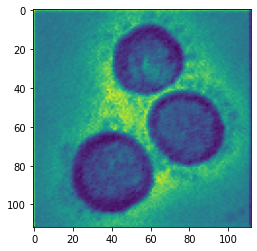

       layer: 3,  channel: 2
(112, 112)
       layer: 3,  channel: 0
(112, 112)
2


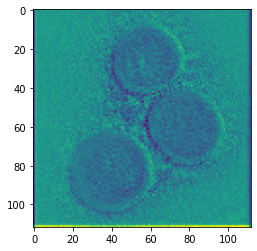

       layer: 3,  channel: 3
(112, 112)
       layer: 3,  channel: 0
(112, 112)
3


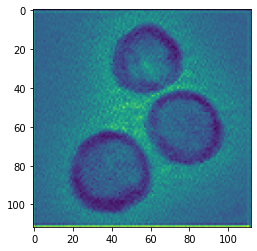

       layer: 3,  channel: 4
(112, 112)
       layer: 3,  channel: 0
(112, 112)
4


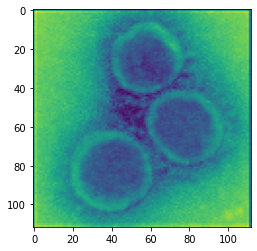

       layer: 3,  channel: 5
(112, 112)
       layer: 3,  channel: 0
(112, 112)
5


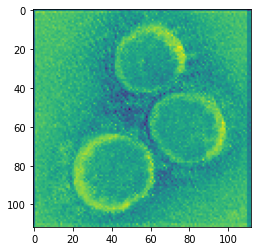

       layer: 3,  channel: 6
(112, 112)
       layer: 3,  channel: 0
(112, 112)
6


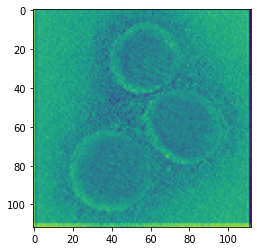

       layer: 3,  channel: 7
(112, 112)
       layer: 3,  channel: 0
(112, 112)
7


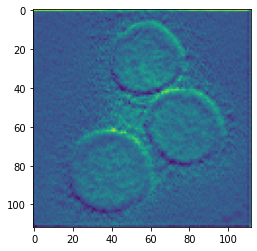

       layer: 3,  channel: 8
(112, 112)
       layer: 3,  channel: 0
(112, 112)
8


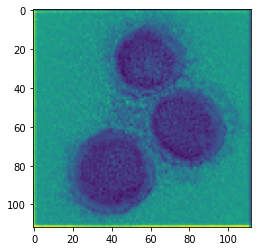

       layer: 3,  channel: 9
(112, 112)
       layer: 3,  channel: 0
(112, 112)
9


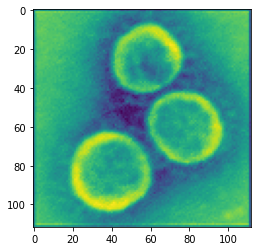

       layer: 3,  channel: 10
(112, 112)
       layer: 3,  channel: 0
(112, 112)
10


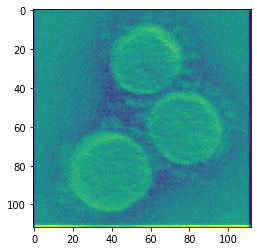

       layer: 3,  channel: 11
(112, 112)
       layer: 3,  channel: 0
(112, 112)
11


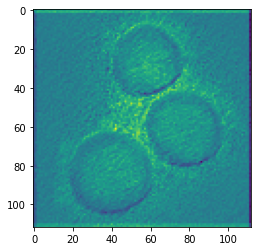

       layer: 3,  channel: 12
(112, 112)
       layer: 3,  channel: 0
(112, 112)
12


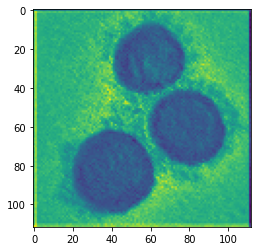

       layer: 3,  channel: 13
(112, 112)
       layer: 3,  channel: 0
(112, 112)
13


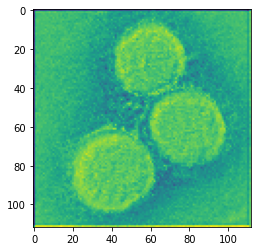

       layer: 3,  channel: 14
(112, 112)
       layer: 3,  channel: 0
(112, 112)
14


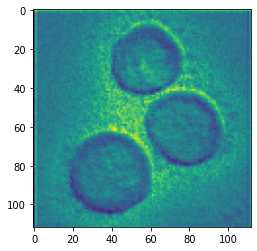

       layer: 3,  channel: 15
(112, 112)
       layer: 3,  channel: 0
(112, 112)
15


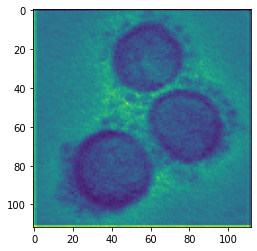

       layer: 3,  channel: 16
(112, 112)
       layer: 3,  channel: 0
(112, 112)
16


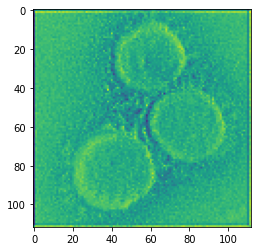

       layer: 3,  channel: 17
(112, 112)
       layer: 3,  channel: 0
(112, 112)
17


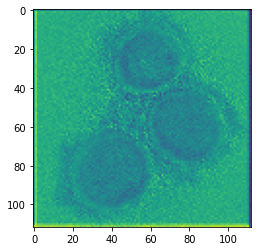

       layer: 3,  channel: 18
(112, 112)
       layer: 3,  channel: 0
(112, 112)
18


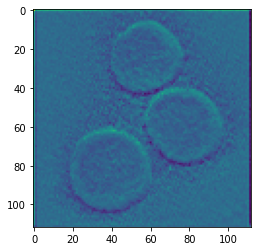

       layer: 3,  channel: 19
(112, 112)
       layer: 3,  channel: 0
(112, 112)
19


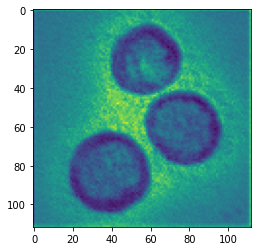

       layer: 3,  channel: 20
(112, 112)
       layer: 3,  channel: 0
(112, 112)
20


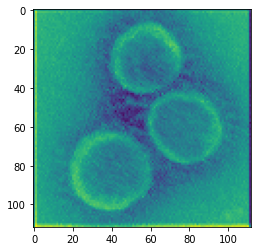

       layer: 3,  channel: 21
(112, 112)
       layer: 3,  channel: 0
(112, 112)
21


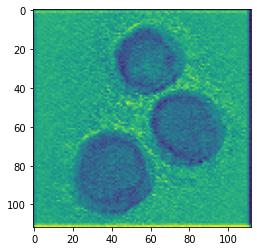

       layer: 3,  channel: 22
(112, 112)
       layer: 3,  channel: 0
(112, 112)
22


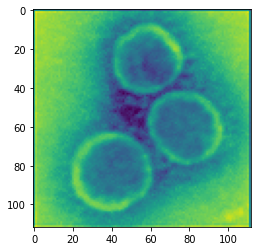

       layer: 3,  channel: 23
(112, 112)
       layer: 3,  channel: 0
(112, 112)
23


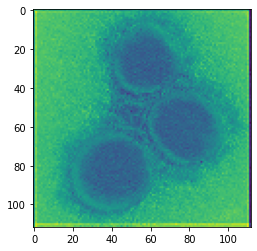

       layer: 3,  channel: 24
(112, 112)
       layer: 3,  channel: 0
(112, 112)
24


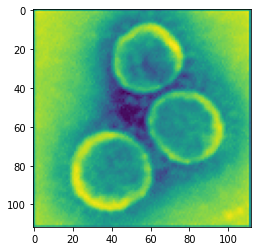

       layer: 3,  channel: 25
(112, 112)
       layer: 3,  channel: 0
(112, 112)
25


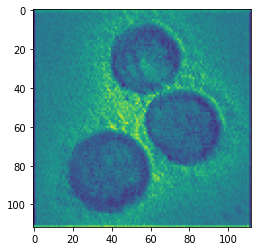

       layer: 3,  channel: 26
(112, 112)
       layer: 3,  channel: 0
(112, 112)
26


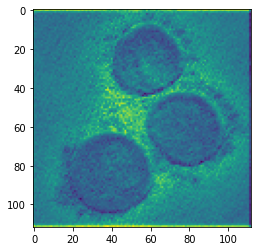

       layer: 3,  channel: 27
(112, 112)
       layer: 3,  channel: 0
(112, 112)
27


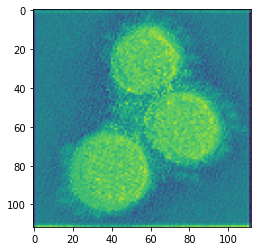

       layer: 3,  channel: 28
(112, 112)
       layer: 3,  channel: 0
(112, 112)
28


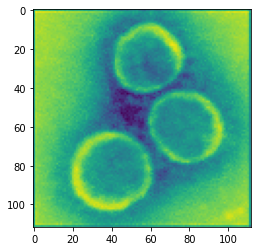

       layer: 3,  channel: 29
(112, 112)
       layer: 3,  channel: 0
(112, 112)
29


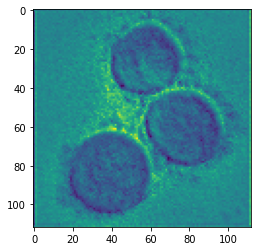

       layer: 3,  channel: 30
(112, 112)
       layer: 3,  channel: 0
(112, 112)
30


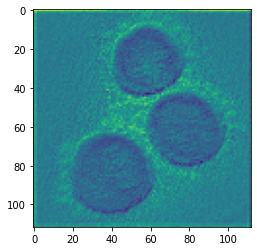

In [89]:
for i in range(0,31):
  imag1 = plotrequiredchannel(3, i)
  imag2 = plotrequiredchannel(3, 0)
  print(i)
  plt.imshow(imag1-imag2)
  plt.show()

       layer: 1,  channel: 2
(224, 224)


array([[0.06031094, 0.20959657, 0.20387481, ..., 0.19350982, 0.1957883 ,
        0.09656226],
       [0.        , 0.06681312, 0.10448035, ..., 0.06458281, 0.09513913,
        0.22289495],
       [0.        , 0.11109599, 0.11059488, ..., 0.09991335, 0.09002788,
        0.23038891],
       ...,
       [0.        , 0.07378694, 0.08205821, ..., 0.08065896, 0.13145705,
        0.21697176],
       [0.        , 0.08440413, 0.09157325, ..., 0.0714828 , 0.08408774,
        0.22879745],
       [0.        , 0.06616219, 0.04637272, ..., 0.03841186, 0.05034351,
        0.2539504 ]], dtype=float32)

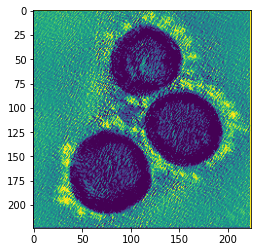

In [90]:
plotrequiredchannel(1, 2)


       layer: 1,  channel: 14
(224, 224)


array([[0.20238787, 0.1447146 , 0.13434133, ..., 0.14576754, 0.13534686,
        0.        ],
       [0.14781481, 0.1580565 , 0.16958693, ..., 0.17043272, 0.1629574 ,
        0.        ],
       [0.16763496, 0.13044682, 0.18561345, ..., 0.17463565, 0.1741941 ,
        0.        ],
       ...,
       [0.14232755, 0.19242114, 0.17841175, ..., 0.197027  , 0.1760928 ,
        0.        ],
       [0.15911224, 0.1611051 , 0.16461107, ..., 0.19460207, 0.20082852,
        0.        ],
       [0.14506733, 0.14078566, 0.16331351, ..., 0.11933408, 0.15563968,
        0.        ]], dtype=float32)

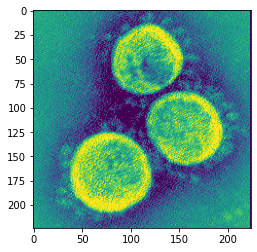

In [91]:
plotrequiredchannel(1, 14)


       layer: 1,  channel: 0
(224, 224)
       layer: 1,  channel: 14
(224, 224)


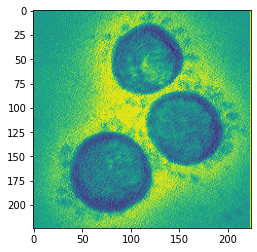

       layer: 1,  channel: 1
(224, 224)
       layer: 1,  channel: 14
(224, 224)


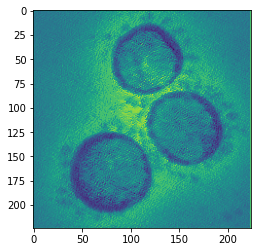

       layer: 1,  channel: 2
(224, 224)
       layer: 1,  channel: 14
(224, 224)


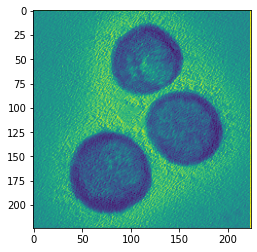

       layer: 1,  channel: 3
(224, 224)
       layer: 1,  channel: 14
(224, 224)


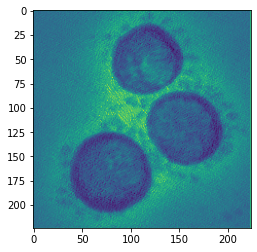

       layer: 1,  channel: 4
(224, 224)
       layer: 1,  channel: 14
(224, 224)


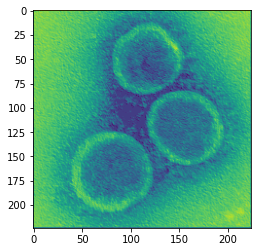

       layer: 1,  channel: 5
(224, 224)
       layer: 1,  channel: 14
(224, 224)


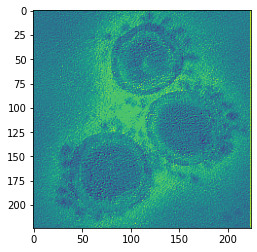

       layer: 1,  channel: 6
(224, 224)
       layer: 1,  channel: 14
(224, 224)


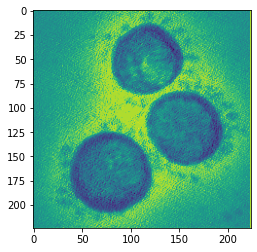

       layer: 1,  channel: 7
(224, 224)
       layer: 1,  channel: 14
(224, 224)


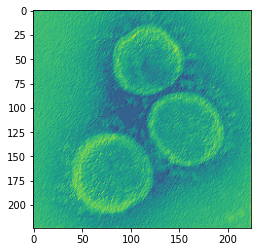

       layer: 1,  channel: 8
(224, 224)
       layer: 1,  channel: 14
(224, 224)


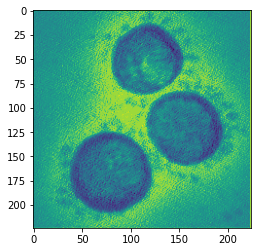

       layer: 1,  channel: 9
(224, 224)
       layer: 1,  channel: 14
(224, 224)


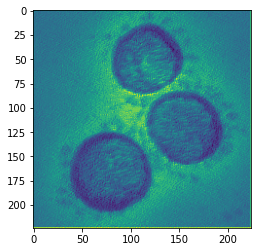

       layer: 1,  channel: 10
(224, 224)
       layer: 1,  channel: 14
(224, 224)


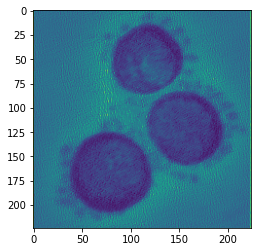

       layer: 1,  channel: 11
(224, 224)
       layer: 1,  channel: 14
(224, 224)


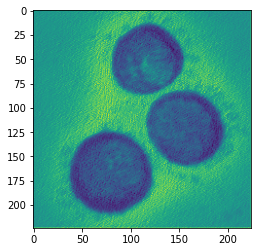

       layer: 1,  channel: 12
(224, 224)
       layer: 1,  channel: 14
(224, 224)


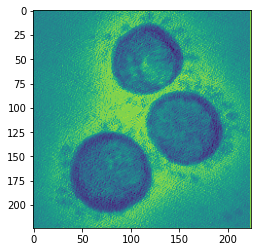

       layer: 1,  channel: 13
(224, 224)
       layer: 1,  channel: 14
(224, 224)


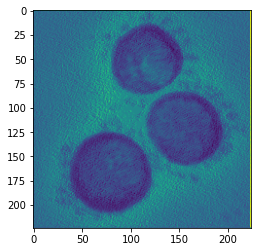

       layer: 1,  channel: 14
(224, 224)
       layer: 1,  channel: 14
(224, 224)


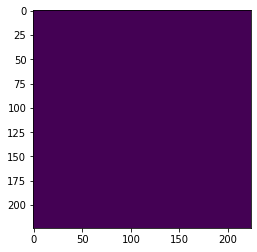

       layer: 1,  channel: 15
(224, 224)
       layer: 1,  channel: 14
(224, 224)


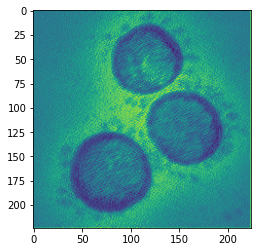

       layer: 1,  channel: 16
(224, 224)
       layer: 1,  channel: 14
(224, 224)


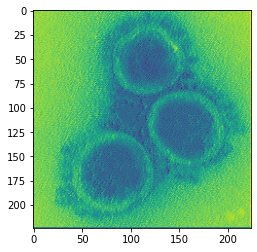

       layer: 1,  channel: 17
(224, 224)
       layer: 1,  channel: 14
(224, 224)


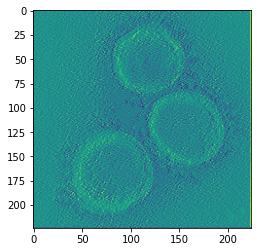

       layer: 1,  channel: 18
(224, 224)
       layer: 1,  channel: 14
(224, 224)


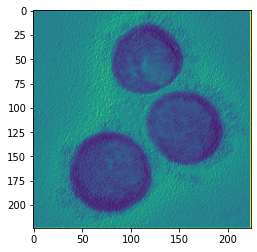

       layer: 1,  channel: 19
(224, 224)
       layer: 1,  channel: 14
(224, 224)


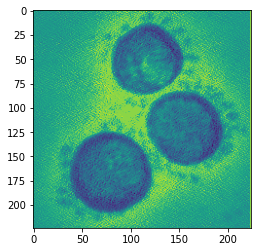

       layer: 1,  channel: 20
(224, 224)
       layer: 1,  channel: 14
(224, 224)


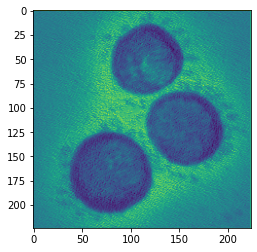

       layer: 1,  channel: 21
(224, 224)
       layer: 1,  channel: 14
(224, 224)


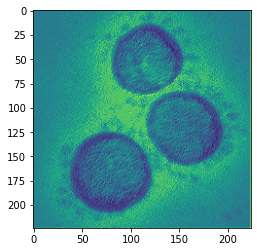

       layer: 1,  channel: 22
(224, 224)
       layer: 1,  channel: 14
(224, 224)


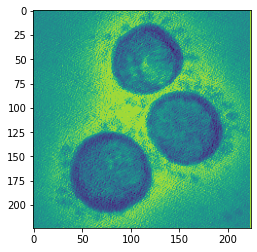

       layer: 1,  channel: 23
(224, 224)
       layer: 1,  channel: 14
(224, 224)


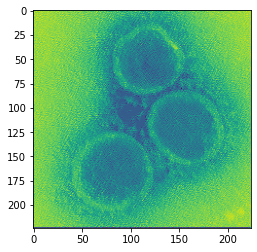

       layer: 1,  channel: 24
(224, 224)
       layer: 1,  channel: 14
(224, 224)


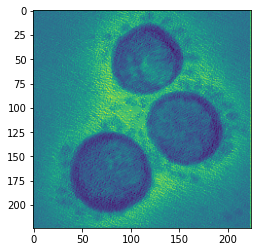

       layer: 1,  channel: 25
(224, 224)
       layer: 1,  channel: 14
(224, 224)


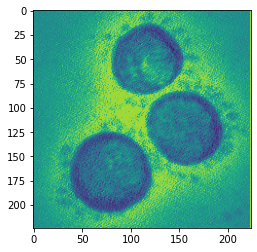

       layer: 1,  channel: 26
(224, 224)
       layer: 1,  channel: 14
(224, 224)


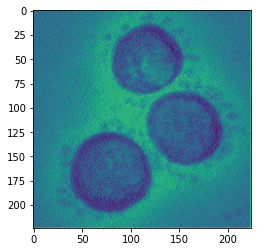

       layer: 1,  channel: 27
(224, 224)
       layer: 1,  channel: 14
(224, 224)


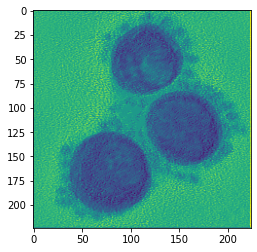

       layer: 1,  channel: 28
(224, 224)
       layer: 1,  channel: 14
(224, 224)


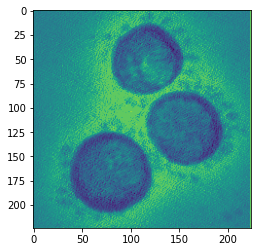

       layer: 1,  channel: 29
(224, 224)
       layer: 1,  channel: 14
(224, 224)


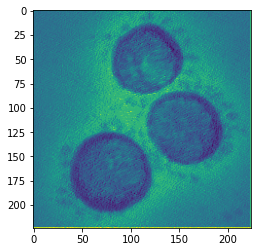

       layer: 1,  channel: 30
(224, 224)
       layer: 1,  channel: 14
(224, 224)


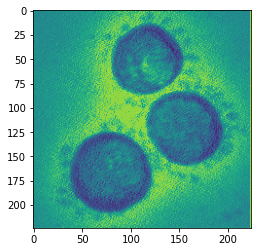

In [92]:
for i in range(0,31):
  imag1 = plotrequiredchannel(1, i)
  imag2 = plotrequiredchannel(1, 14)
  plt.imshow(imag1-imag2)
  plt.show()


       layer: 1,  channel: 31
(224, 224)


array([[0.09298258, 0.01772547, 0.03978729, ..., 0.01563051, 0.01334854,
        0.        ],
       [0.1931692 , 0.04565483, 0.08347157, ..., 0.0741777 , 0.05789407,
        0.        ],
       [0.20272186, 0.06897294, 0.05231143, ..., 0.08597526, 0.05329891,
        0.        ],
       ...,
       [0.16701798, 0.04683542, 0.06205038, ..., 0.07904685, 0.04503573,
        0.        ],
       [0.16445565, 0.06215484, 0.07594153, ..., 0.0312694 , 0.08288994,
        0.        ],
       [0.22350655, 0.22673137, 0.22699936, ..., 0.23911811, 0.2380207 ,
        0.        ]], dtype=float32)

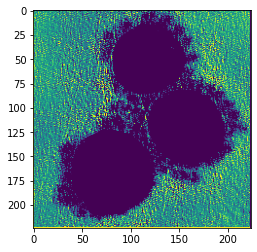

In [93]:
plotrequiredchannel(1, 31)


       layer: 1,  channel: 31
(224, 224)


array([[0.09298258, 0.01772547, 0.03978729, ..., 0.01563051, 0.01334854,
        0.        ],
       [0.1931692 , 0.04565483, 0.08347157, ..., 0.0741777 , 0.05789407,
        0.        ],
       [0.20272186, 0.06897294, 0.05231143, ..., 0.08597526, 0.05329891,
        0.        ],
       ...,
       [0.16701798, 0.04683542, 0.06205038, ..., 0.07904685, 0.04503573,
        0.        ],
       [0.16445565, 0.06215484, 0.07594153, ..., 0.0312694 , 0.08288994,
        0.        ],
       [0.22350655, 0.22673137, 0.22699936, ..., 0.23911811, 0.2380207 ,
        0.        ]], dtype=float32)

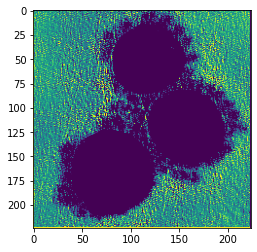

In [94]:
plotrequiredchannel(1, 31)


In [0]:
grads = K.gradients(loss, model.input)[0]


In [0]:
grads /= (K.sqrt(K.mean(K.square(grads))) + 1e-5)


In [0]:
iterate = K.function([model.input], [loss, grads])

# Let's test it:
import numpy as np
loss_value, grads_value = iterate([np.zeros((1, 150, 150, 3))])

In [0]:
# We start from a gray image with some noise
input_img_data = np.random.random((1, 150, 150, 3)) * 20 + 128.

# Run gradient ascent for 40 steps
step = 1.  # this is the magnitude of each gradient update
for i in range(40):
    # Compute the loss value and gradient value
    loss_value, grads_value = iterate([input_img_data])
    # Here we adjust the input image in the direction that maximizes the loss
    input_img_data += grads_value * step

In [0]:
def deprocess_image(x):
    # normalize tensor: center on 0., ensure std is 0.1
    x -= x.mean()
    x /= (x.std() + 1e-5)
    x *= 0.1

    # clip to [0, 1]
    x += 0.5
    x = np.clip(x, 0, 1)

    # convert to RGB array
    x *= 255
    x = np.clip(x, 0, 255).astype('uint8')
    return x

In [0]:
def generate_pattern(layer_name, filter_index, size=150):
    # Build a loss function that maximizes the activation
    # of the nth filter of the layer considered.
    layer_output = model.get_layer(layer_name).output
    loss = K.mean(layer_output[:, :, :, filter_index])

    # Compute the gradient of the input picture wrt this loss
    grads = K.gradients(loss, model.input)[0]

    # Normalization trick: we normalize the gradient
    grads /= (K.sqrt(K.mean(K.square(grads))) + 1e-5)

    # This function returns the loss and grads given the input picture
    iterate = K.function([model.input], [loss, grads])
    
    # We start from a gray image with some noise
    input_img_data = np.random.random((1, size, size, 3)) * 20 + 128.

    # Run gradient ascent for 40 steps
    step = 1.
    for i in range(40):
        loss_value, grads_value = iterate([input_img_data])
        input_img_data += grads_value * step
        
    img = input_img_data[0]
    return deprocess_image(img)

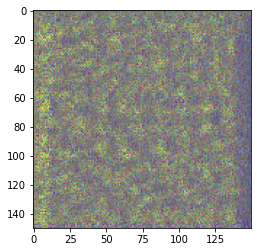

In [102]:
plt.imshow(generate_pattern('conv2d_4', 3))
plt.show()

In [0]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec



for j in range(2):
  
  plt.figure(figsize = (16,16))
  gs1 = gridspec.GridSpec(4, 4)
  gs1.update(wspace=0.005, hspace=0.005) # set the spacing between axes. 

  for i in range(16):
     # i = i + 1 # grid spec indexes from 0

      img = generate_pattern('conv2d_3', i + 16*j)

      ax1 = plt.subplot(gs1[i])
      plt.axis('off')
      ax1.set_aspect('equal')
      plt.imshow(img)

  plt.show()

In [0]:

import os
logdir = os.path.join("logs", "myexp1")
tensorboard_callback = keras.callbacks.TensorBoard(logdir, histogram_freq=1)


In [0]:
import tensorflow as tf



In [0]:
load_ext tensorboard


In [0]:
%reload_ext tensorboard

In [0]:
#!kill 426

In [110]:
activation_model.summary()

Model: "model_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1_input (InputLayer)  (None, 224, 224, 3)       0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 224, 224, 32)      896       
_________________________________________________________________
activation_1 (Activation)    (None, 224, 224, 32)      0         
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 112, 112, 32)      0         
Total params: 896
Trainable params: 896
Non-trainable params: 0
_________________________________________________________________


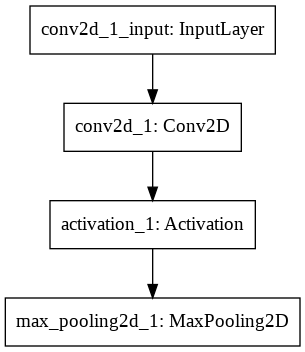

In [111]:
from keras.utils import plot_model
plot_model(activation_model, to_file='model.png')

In [112]:
%tensorboard — logdir logs


ERROR: Failed to launch TensorBoard (exited with 2).
Contents of stderr:
2020-04-30 18:20:45.071559: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libcudart.so.10.1
usage: tensorboard [-h] [--helpfull] {serve,dev} ...
tensorboard: error: invalid choice: '—' (choose from 'serve', 'dev')

In [113]:
data_list[0].shape

(128, 224, 224, 3)

In [114]:
data_list[0][19].shape

(224, 224, 3)